In [13]:
import numpy as np
import matplotlib.pyplot as plt


nx = 51
nz=51
cx=1
cz=1
dx=100.0
dz=100.0
dt=50
cp=1004.0
trigpi = 4.0*np.arctan(1.0)
rd=287.0
cv=cp-rd
rcpd= rd/cp
p0=100000.0
psurf=96500.0
grav=9.81
pott = 343.0
Ttr=213.0
Lv=2.5*(10**6)
radx=1000
radz=1000
delt=10
pisfc=(psurf/p0)**rcpd
y=np.empty([nz])
x=np.empty([nx])
rd2x=1.0/(2.0*dx)
rd2z=1.0/(2.0*dz)
timend=4900

for k in range(1,nz):
    y[k]=(k*dz-dz)
for i in range(1,nx):
    x[i]=(i*dx-dx)


vp=np.empty([nx,nz])
v=np.empty([nx,nz])
vm=np.empty([nx,nz])

qv=np.empty([nx,nz])
imid=(nx-1)/2
kmid=(nz-1)/2
for i in range(1,nx-1):
    for k in range(1,nz-1):
        argz=((dz*(k-kmid)/radz))**2
        argx=((dx*(i-imid))/radx)**2
        rad=np.sqrt(argz+argx)
        if rad <= 1:
         v[i,k]=0.5*delt*(np.cos(trigpi*rad)+1)
        else:
         v[i,k]=0.0

for k in range(1,nz):
    v[0,k]=v[nx-2,k]
    v[nx-1,k]=v[1,k]
for i in range(0, nx):
    v[i,0]=v[i,nz-2]
    v[i,nz-1]=v[i,1]
    
vm = np.copy(v)
d2t=dt
levels=np.arange(0,14,2)
t=0

C:\Users\wflam\Anaconda2\lib\site-packages\matplotlib\pyplot.py:528: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


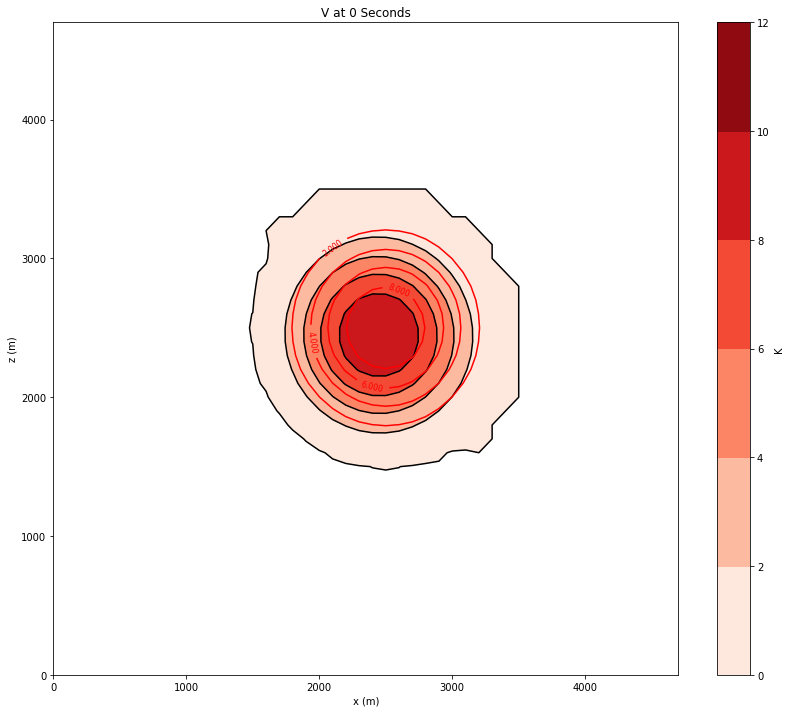

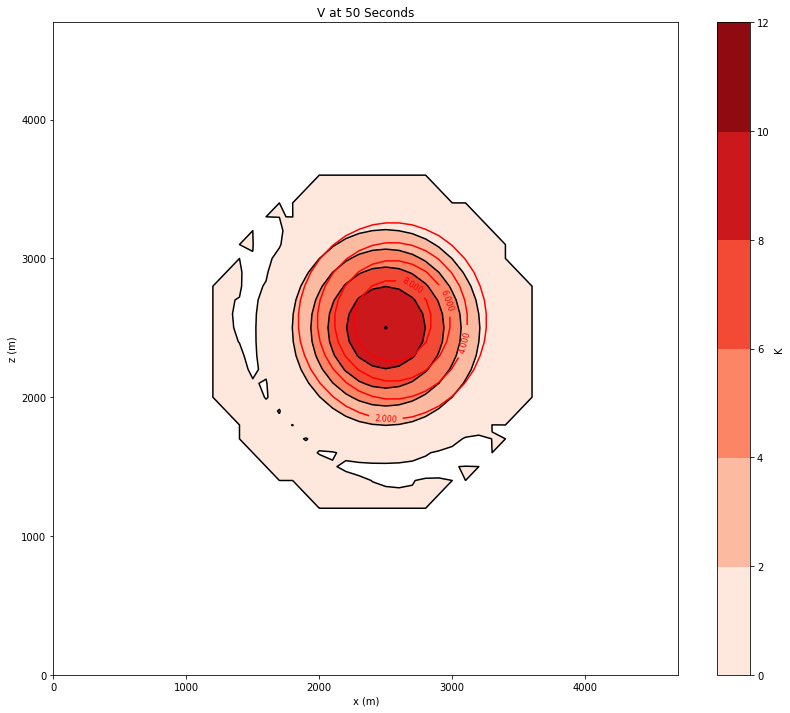

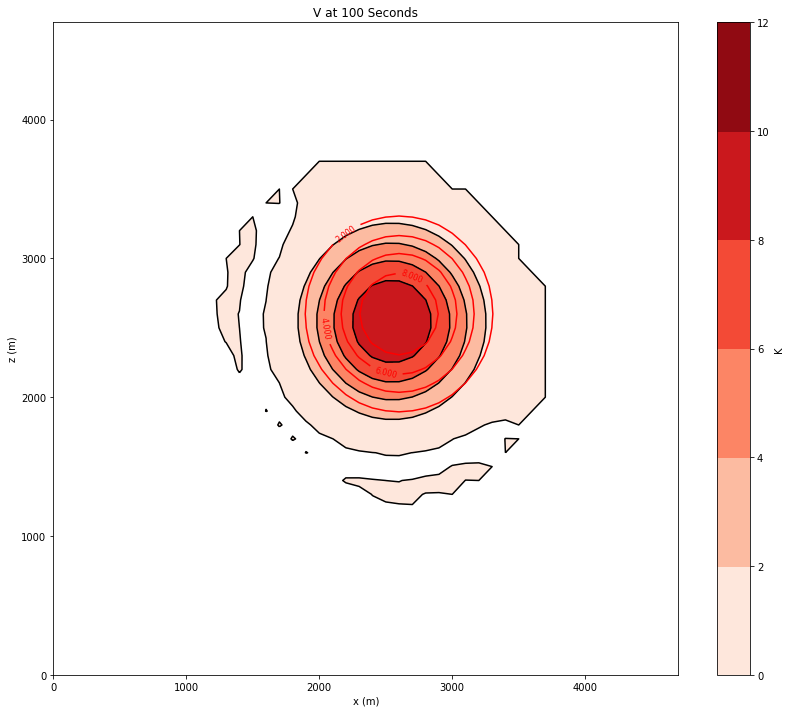

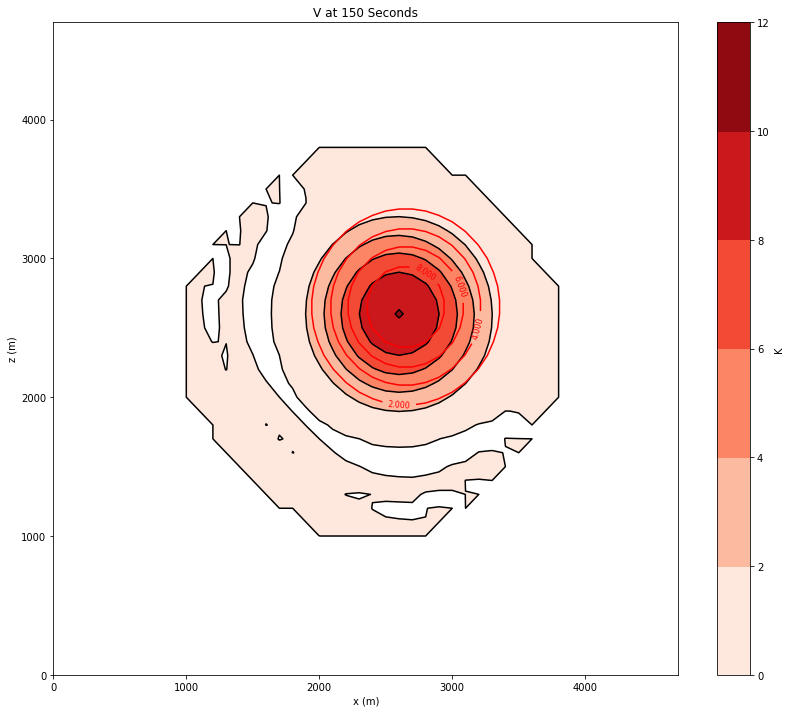

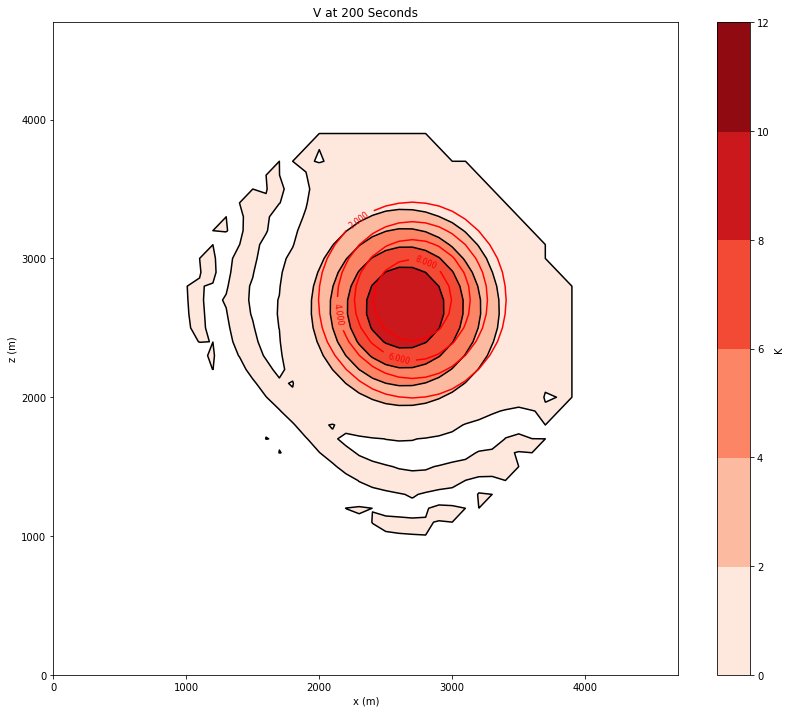

...

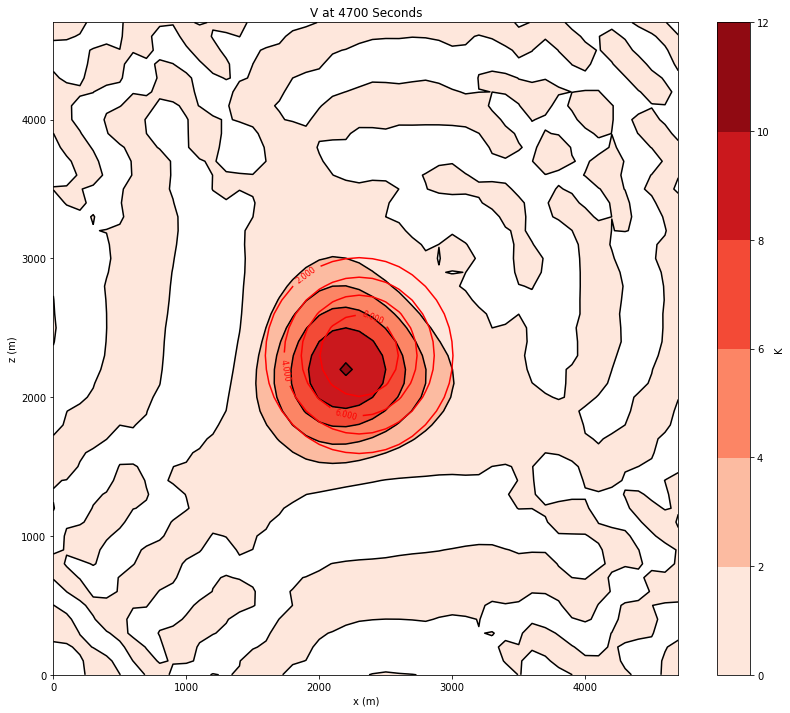

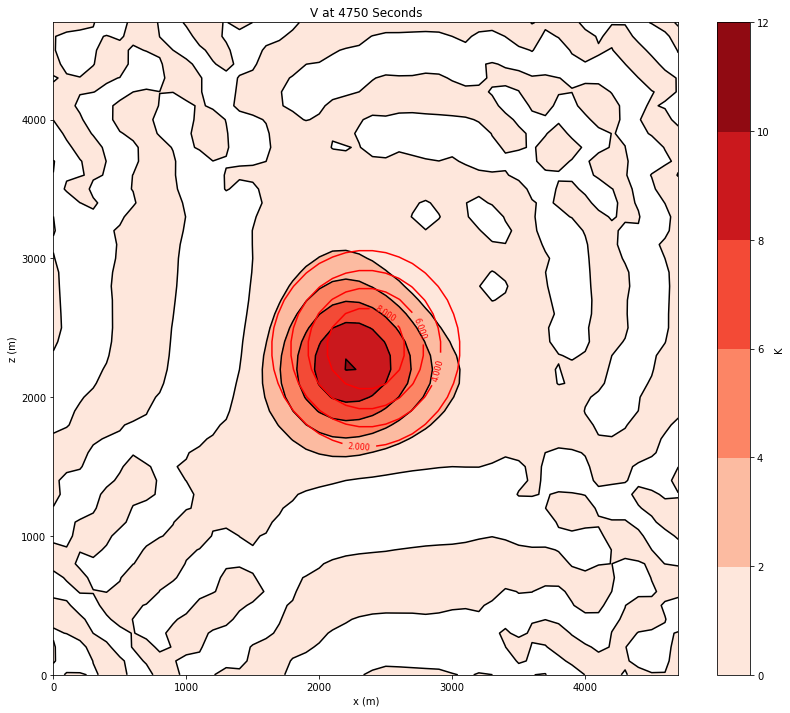

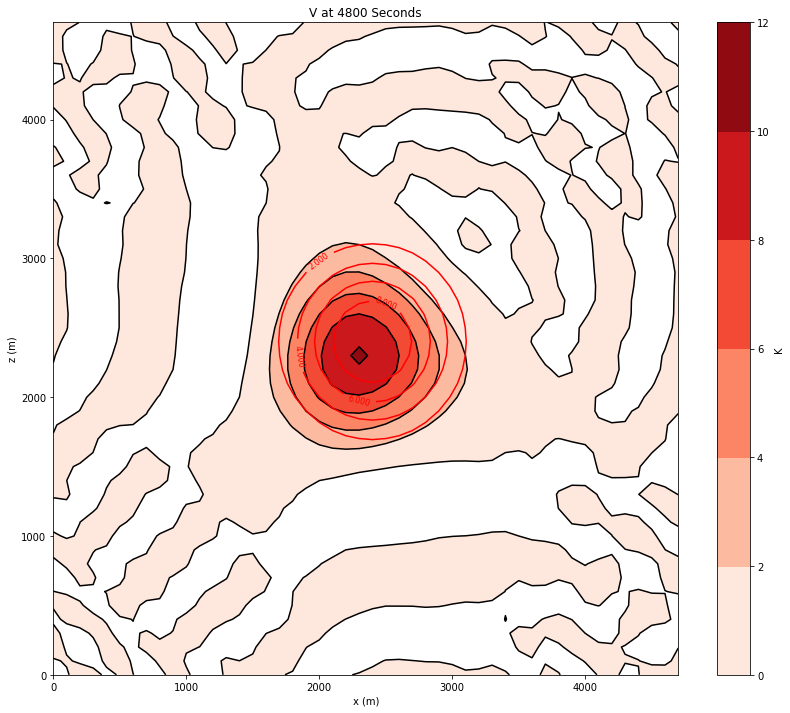

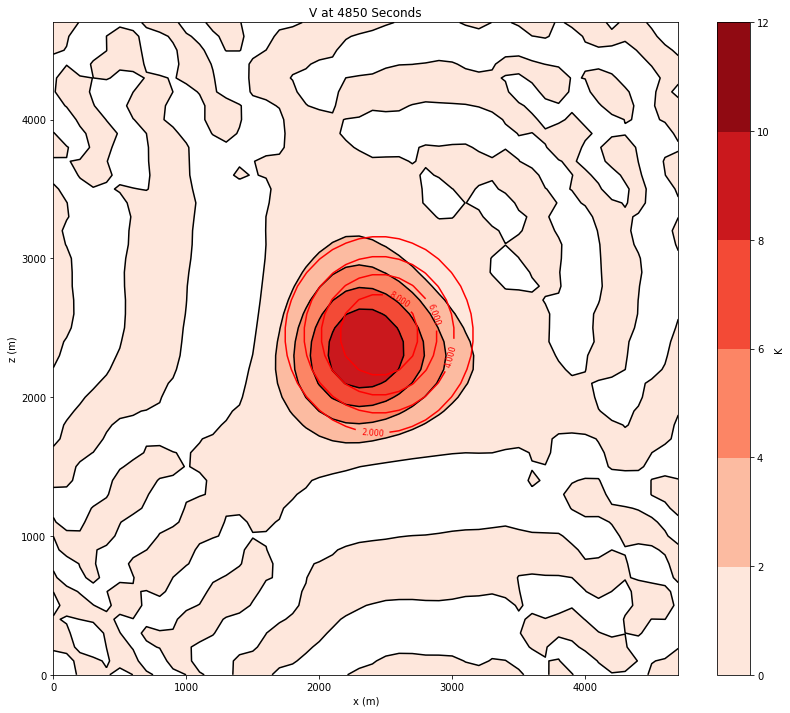

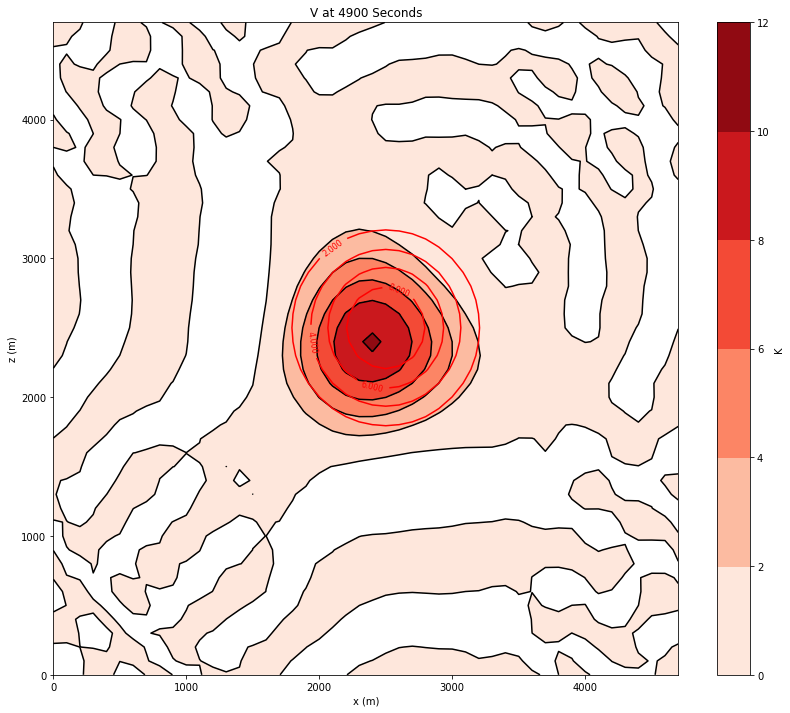

In [14]:



while t <= timend:
    for i in range(1,nx-1):
        for k in range(1,nz-1):
            vp[i,k]=vm[i,k]-cx*d2t*rd2x*(v[i+1,k]-v[i-1,k]) - cz*d2t*rd2z*(v[i,k+1]-v[i,k-1])
     
    
    
  
    for k in range(1,nz):
        vp[0,k]=vp[nx-2,k]
        vp[nx-1,k]=vp[1,k]
    for i in range(0, nx):
        vp[i,0]=vp[i,nz-2]
        vp[i,nz-1]=vp[i,1]
    vm = np.copy(v)
    v = np.copy(vp)
    vp *=0.0
    
    xmid=dx*(nx+1)/2+cx*(t/dt)*dt
    zmid=dz*(nz+1)/2+cz*(t/dt)*dt
    if xmid >= nx*dx: 
        xmid=xmid-(nx-2)*dx
    if zmid >= nz*dz: 
        zmid=zmid-(nz-2)*dz
    if xmid > dx*(nx+1)/2:
        xmidmirror=xmid-(nx-2)*dx
    else:
        xmidmirror=xmid+(nx-2)*dx
    
    if zmid > dz*(nz+1)/2:
        zmidmirror=zmid-(nz-2)*dz
    else:
        zmidmirror=zmid+(nz-2)*dz

    qv *= 0.0
    
    
    for  i in range(1,nx-1):
          for k in range(1,nz-1):
               xi=float(i)*dx
               zk=float(k)*dz
       
               xloc=((xi-xmid)/radx)**2
               zloc=((zk-zmid)/radz)**2

               xlocmirror=((xmidmirror-xi)/radx)**2
               zlocmirror=((zmidmirror-zk)/radz)**2	

               #xloc=np.amin(xloc,xlocmirror)
               #zloc=np.amin(zloc,zlocmirror)
               rad=np.sqrt(xloc+zloc)

               if rad < 1: 
                    qv[i,k]=.5*delt*(np.cos(trigpi*rad)+1.0) 
 
     

    d2t=dt*2.0
   
    plt.figure(figsize=(14,12))
    plt.clf()
    plt.contourf(x[1:nx-2],y[1:nz-2],v[1:nx-2,1:nz-2],cmap='Reds',levels=levels)
    plt.colorbar(label='K')
    CS=plt.contour(x[1:nx-2],y[1:nz-2],v[1:nx-2,1:nz-2],colors='k',levels=levels)
    CS=plt.contour(x[1:nx-2],y[1:nz-2],qv[1:nx-2,1:nz-2],colors='r',levels=levels)
    plt.xlabel('x (m)')
    plt.ylabel('z (m)')
    plt.clabel(CS,fontsize=8, inline=1)
    plt.title('V at {0} Seconds'.format(t))
    plt.savefig('v_predic_{0}sec'.format(t), dpi=120)
    #plt.show()
    t=t+dt
    




